## Table of Contents

1. [Introduction](#section1)<br>
  1.1 [Problem Statement](#section1.1)<br>
2. [Approach](#section2)<br>
  2.1 [Apriori Usecases](#section2.1)<br>
3. [Environment Setup (Importing Libraries)](#section3)<br>
4. [Exploratory Data Analysis (EDA)](#section4)<br>
5. [Build ML Models](#section5)<br>
  5.1 [Item-Item Recommendation System](#section5.1)<br>
  5.2 [Applying Apriori Algorithm](#section5.2)<br>
6. [Conclusion](#section6)<br>


# Introduction

## Problem Statement
As the owner of the store, I need to understand 
- identify the fast moving products
- how do we place the products such that we are able to increase the overall sales

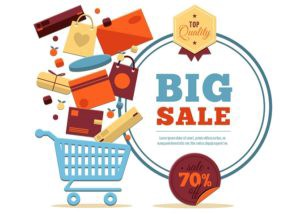

# Approach
To understand the fast moving products and applying the promotional rules for driving up sales, approach would be - 
- find frequent associations between the items being bought 
- recommend customers 
- strategise product placements on the shelf
- apply promotions


The following algorithm can be applied to achieve the goal -
- Apriori




### Apriori Usecaes
- a dataset with each row representing a transaction and each column an individual item of the transaction
  - the association rules can be determined 
- a data set from a supermarket sales data by SKUs (stock-keeping units) where each transaction is a set of SKUs that were bought together
  - determine the frequent item sets of this dataset
  - setup the rule that if the SKU is part of atlest 3 baskets, it's classified as frequent item 

- uses a "bottom up" approach, where frequent subsets are extended one item at a time 


# Environment Setup (Importing Libraries)

In [59]:
import pandas as pd
import numpy as np
from IPython.display import display

import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from matplotlib.colors import ListedColormap
%matplotlib inline

import mpl_toolkits
from mpl_toolkits.mplot3d import Axes3D
from graphviz import Source
from IPython.display import Image

import warnings
warnings.filterwarnings('ignore')  

import seaborn as sns
sns.set()

pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)

In [60]:
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn import metrics

In [61]:
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

from mlxtend.preprocessing import TransactionEncoder


In [62]:
#consolidated basket list

groceries_df=pd.read_csv('https://raw.githubusercontent.com/rupkohli/DS_ML_Research/main/clustering/groceries.csv',sep=';', header=None)

groceries_df.head(10)


,0
0,"citrus fruit,semi-finished bread,margarine,rea..."
1,"tropical fruit,yogurt,coffee"
2,whole milk
3,"pip fruit,yogurt,cream cheese,meat spreads"
4,"other vegetables,whole milk,condensed milk,lon..."
5,"whole milk,butter,yogurt,rice,abrasive cleaner"
6,rolls/buns
7,"other vegetables,UHT-milk,rolls/buns,bottled b..."
8,potted plants
9,"whole milk,cereals"


# Exploratory Data Analysis (EDA)

In [63]:
type(groceries_df)

pandas.core.frame.DataFrame

In [ ]:
#groceries_list = groceries_df.values.tolist()

In [ ]:
#type(groceries_list)

In [ ]:
#groceries_list[:10]

In [64]:
groceries_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9835 entries, 0 to 9834
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
dtypes: object(1)
memory usage: 77.0+ KB


In [65]:
groceries_df.columns = ['basket']

In [66]:
groceries = pd.DataFrame(groceries_df.basket.str.lower())

groceries[:10]

,basket
0,"citrus fruit,semi-finished bread,margarine,rea..."
1,"tropical fruit,yogurt,coffee"
2,whole milk
3,"pip fruit,yogurt,cream cheese,meat spreads"
4,"other vegetables,whole milk,condensed milk,lon..."
5,"whole milk,butter,yogurt,rice,abrasive cleaner"
6,rolls/buns
7,"other vegetables,uht-milk,rolls/buns,bottled b..."
8,potted plants
9,"whole milk,cereals"


In [68]:
grocery_basket_df = (
    groceries['basket']
    .apply(pd.Series)
    
)
grocery_basket_df[:10]

,0
0,"citrus fruit,semi-finished bread,margarine,rea..."
1,"tropical fruit,yogurt,coffee"
2,whole milk
3,"pip fruit,yogurt,cream cheese,meat spreads"
4,"other vegetables,whole milk,condensed milk,lon..."
5,"whole milk,butter,yogurt,rice,abrasive cleaner"
6,rolls/buns
7,"other vegetables,uht-milk,rolls/buns,bottled b..."
8,potted plants
9,"whole milk,cereals"


In [ ]:
#grocery_basket_df.reset_index(inplace=True)

In [67]:
grocery_basket_df.shape

(9835, 1)

In [69]:
grocery_basket_df.columns = ['basket']

In [70]:
grocery_basket_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9835 entries, 0 to 9834
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   basket  9835 non-null   object
dtypes: object(1)
memory usage: 77.0+ KB


In [72]:
grocery_basket_df.head()

,basket
0,"citrus fruit,semi-finished bread,margarine,rea..."
1,"tropical fruit,yogurt,coffee"
2,whole milk
3,"pip fruit,yogurt,cream cheese,meat spreads"
4,"other vegetables,whole milk,condensed milk,lon..."


**Task is to analyse the available 9835 baskets and find association rules i.e. which items are bought together**

Based on the items being bought together, the store can create discount rules or buy-one-get-one offers

### Extract items from baskets (Data Pre-processing)

In [73]:
# Extract the items to new columns
grocery_basket_in_df = grocery_basket_df['basket'].str.split(',', expand=True)

grocery_basket_in_df.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
0,citrus fruit,semi-finished bread,margarine,ready soups,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,tropical fruit,yogurt,coffee,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,whole milk,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,pip fruit,yogurt,cream cheese,meat spreads,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,other vegetables,whole milk,condensed milk,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5,whole milk,butter,yogurt,rice,abrasive cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6,rolls/buns,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7,other vegetables,uht-milk,rolls/buns,bottled beer,liquor (appetizer),None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
8,potted plants,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
9,whole milk,cereals,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [74]:
grocery_basket_in_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9835 entries, 0 to 9834
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
 1   1       7676 non-null   object
 2   2       6033 non-null   object
 3   3       4734 non-null   object
 4   4       3729 non-null   object
 5   5       2874 non-null   object
 6   6       2229 non-null   object
 7   7       1684 non-null   object
 8   8       1246 non-null   object
 9   9       896 non-null    object
 10  10      650 non-null    object
 11  11      468 non-null    object
 12  12      351 non-null    object
 13  13      273 non-null    object
 14  14      196 non-null    object
 15  15      141 non-null    object
 16  16      95 non-null     object
 17  17      66 non-null     object
 18  18      52 non-null     object
 19  19      38 non-null     object
 20  20      29 non-null     object
 21  21      18 non-null     object
 22  22      14 non-null     

**Data Cleanup**
- rename liqueur; liquor; liquor (appetizer) to liquor
- rename bags to cling film/bags

In [75]:

grocery_basket_in_df.replace(to_replace=['liqueur'],
           value= ['liquor'], 
           inplace=True)

grocery_basket_in_df.replace(to_replace=['liquor (appetizer)'],
           value= ['liquor'], 
           inplace=True)


grocery_basket_in_df.replace(to_replace=['bags'],
           value= ['cling film/bags'], 
           inplace=True)
grocery_basket_in_df.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
0,citrus fruit,semi-finished bread,margarine,ready soups,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1,tropical fruit,yogurt,coffee,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
2,whole milk,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3,pip fruit,yogurt,cream cheese,meat spreads,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,other vegetables,whole milk,condensed milk,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5,whole milk,butter,yogurt,rice,abrasive cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6,rolls/buns,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7,other vegetables,uht-milk,rolls/buns,bottled beer,liquor,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
8,potted plants,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
9,whole milk,cereals,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [76]:
grocery_basket_in_df.sort_values(by=[0,1], ascending=[False,False], inplace=True)


In [77]:
grocery_basket_in_df.head(30)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [78]:
count = pd.Series(grocery_basket_in_df.squeeze().values.ravel()).value_counts()
grocery_list_cleaned = pd.DataFrame({'Item_Name': count.index, 'Frequently_Bought':count.values})
grocery_list_cleaned[:20]#.sort_values(by=['Item_Name'], ascending=True, inplace=True)

,Item_Name,Frequently_Bought
0,whole milk,2513
1,other vegetables,1903
2,rolls/buns,1809
3,soda,1715
4,yogurt,1372
5,bottled water,1087
6,root vegetables,1072
7,tropical fruit,1032
8,shopping bags,969
9,sausage,924


In [79]:
grocery_list_cleaned.Item_Name.unique()

array(['whole milk', 'other vegetables', 'rolls/buns', 'soda', 'yogurt',
       'bottled water', 'root vegetables', 'tropical fruit',
       'shopping bags', 'sausage', 'pastry', 'citrus fruit',
       'bottled beer', 'newspapers', 'canned beer', 'pip fruit',
       'fruit/vegetable juice', 'whipped/sour cream', 'brown bread',
       'domestic eggs', 'frankfurter', 'margarine', 'coffee', 'pork',
       'butter', 'curd', 'beef', 'napkins', 'chocolate',
       'frozen vegetables', 'chicken', 'white bread', 'cream cheese',
       'waffles', 'salty snack', 'long life bakery product', 'dessert',
       'sugar', 'uht-milk', 'hamburger meat', 'berries',
       'hygiene articles', 'onions', 'specialty chocolate', 'candy',
       'misc. beverages', 'frozen meals', 'oil', 'butter milk',
       'specialty bar', 'ham', 'beverages', 'meat', 'ice cream',
       'hard cheese', 'sliced cheese', 'cat food', 'grapes',
       'chewing gum', 'liquor', 'detergent', 'red/blush wine',
       'white wine', 'p

In [80]:
grocery_list_cleaned

,Item_Name,Frequently_Bought
0,whole milk,2513
1,other vegetables,1903
2,rolls/buns,1809
3,soda,1715
4,yogurt,1372
5,bottled water,1087
6,root vegetables,1072
7,tropical fruit,1032
8,shopping bags,969
9,sausage,924


In [81]:
grocery_list_cleaned.sort_values(by='Frequently_Bought', ascending=False, inplace=True)
grocery_list_cleaned.head(20)

,Item_Name,Frequently_Bought
0,whole milk,2513
1,other vegetables,1903
2,rolls/buns,1809
3,soda,1715
4,yogurt,1372
5,bottled water,1087
6,root vegetables,1072
7,tropical fruit,1032
8,shopping bags,969
9,sausage,924


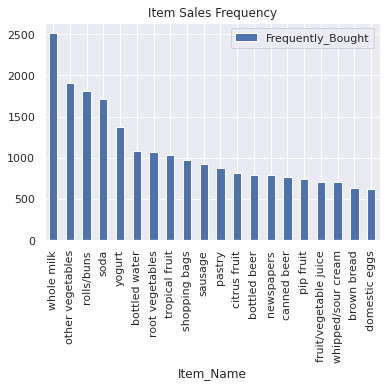

In [82]:
grocery_list_cleaned[:20].plot(x='Item_Name', y='Frequently_Bought', kind='bar');
plt.title("Item Sales Frequency");


**Top 20 frequently bought items**
- whole milk	2513
-	other vegetables	1903
-	rolls/buns	1809
-	soda	1715
-	yogurt	1372
-	bottled water	1087
-	root vegetables	1072
-	tropical fruit	1032
-	shopping bags	969
-	sausage	924
-	pastry	875
-	citrus fruit	814
-	bottled beer	792
-	newspapers	785
-	canned beer	764
-	pip fruit	744
-	fruit/vegetable juice	711
-	whipped/sour cream	705
-	brown bread	638
-	domestic eggs 624

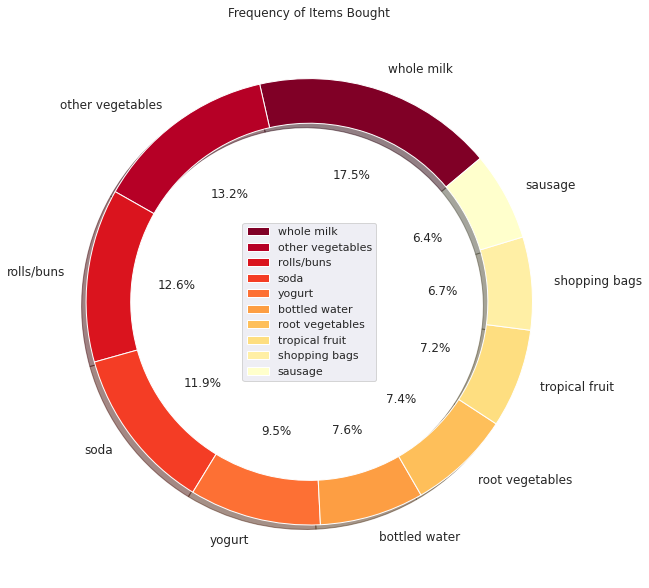

In [83]:
space = np.ones((10))/10
grocery_list_cleaned['Frequently_Bought'][:10].plot(kind='pie', #explode=1, 
                             fontsize=12, autopct='%3.1f%%', wedgeprops=dict(width=0.2), 
                               shadow=True, startangle=40, figsize=(10,12), cmap='YlOrRd_r',legend=True,
                               labels=grocery_list_cleaned['Item_Name'])

plt.ylabel(None)
plt.title('Frequency of Items Bought')
plt.show()



Per the above visual; 7.6% of the baskets contain bottled water and other 6.7% baskets contain shopping bags.
Since these 2 items are not so important, we will **remove these from further analysis - bottled water and shopping bags**

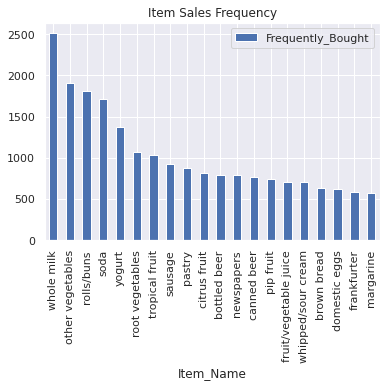

In [84]:
grocery_list_re_cleaned = grocery_list_cleaned[~grocery_list_cleaned['Item_Name'].isin(['bottled water','shopping bags'])]
grocery_list_re_cleaned[:20].plot(x='Item_Name', y='Frequently_Bought', kind='bar');
plt.title("Item Sales Frequency");

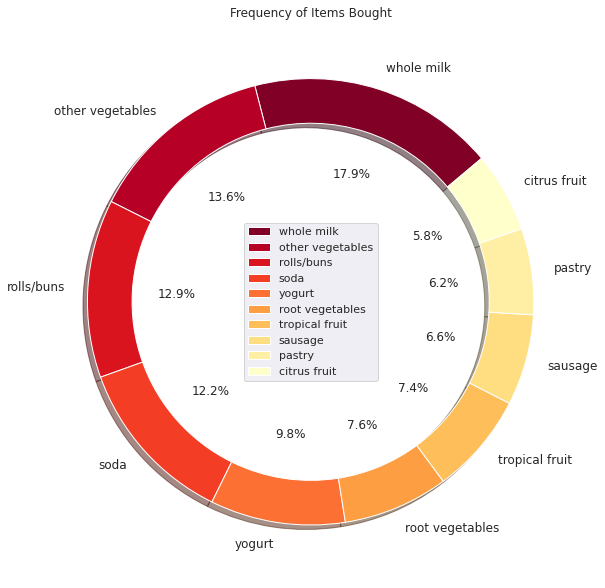

In [85]:
space = np.ones((10))/10
grocery_list_re_cleaned['Frequently_Bought'][:10].plot(kind='pie', #explode=1, 
                             fontsize=12, autopct='%3.1f%%', wedgeprops=dict(width=0.2), 
                               shadow=True, startangle=40, figsize=(10,12), cmap='YlOrRd_r',legend=True,
                               labels=grocery_list_re_cleaned['Item_Name'])

plt.ylabel(None)
plt.title('Frequency of Items Bought')
plt.show()



In [86]:
value_to_remove=['bottled water','shopping bags']

df_basket_cleaned=grocery_basket_in_df.applymap(lambda x: 'None' if x in value_to_remove else x)

In [87]:
df_basket_cleaned[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [88]:
grocery_basket_in_df[:20]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


**Data formatting**

Since we will be applying The Apriori algoritm, we will need to format the dataset as - 
- in the form of a list of lists, where the whole dataset is a big list and each transaction in the dataset is an inner list within the outer big list. 

In [89]:
grocery_basket_apriori_form = df_basket_cleaned.fillna('0')
#grocery_basket_apriori_form.drop(columns='item_count',inplace=True)
grocery_basket_apriori_form.columns

RangeIndex(start=0, stop=32, step=1)

In [90]:
# date format for applying the apriori algorithm - grocery_basket_list
grocery_basket_list = grocery_basket_apriori_form.values.tolist()
grocery_basket_list[:20]

[['zwieback',
  'salty snack',
  'popcorn',
  'waffles',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'oil',
  'mustard',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  'dental care',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',

## Most Buys

Using the data format as per grocery_basket_in_df; extract the frquently bought items 

In [91]:
count = pd.Series(df_basket_cleaned.squeeze().values.ravel()).value_counts()
most_buys = pd.DataFrame({'Item_Name': count.index, 'Frequently_Bought':count.values})
most_buys#.head(20)

,Item_Name,Frequently_Bought
0,whole milk,2513
1,None,2056
2,other vegetables,1903
3,rolls/buns,1809
4,soda,1715
5,yogurt,1372
6,root vegetables,1072
7,tropical fruit,1032
8,sausage,924
9,pastry,875


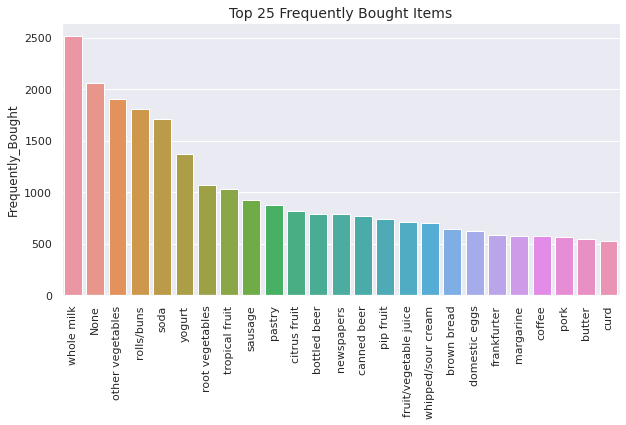

In [92]:
plt.figure(figsize=(10,5));
sns.barplot(data=most_buys[:25], x="Item_Name", y="Frequently_Bought",);
plt.xlabel(xlabel= '',fontsize=12);
# Rotate x-labels
plt.title("Top 25 Frequently Bought Items", fontsize=14);
plt.xticks(rotation=90);

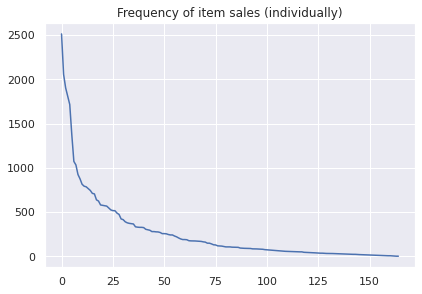

In [93]:
most_buys.Frequently_Bought.plot();
plt.tight_layout(pad=1);
plt.title("Frequency of item sales (individually)");

In [94]:
most_buys.shape

(165, 2)

## No. of Items in Baskets

In [95]:
# insert column item_count to count the number of items in the baskets
df_basket_cleaned.insert(0, 'item_count',0)

for col in grocery_basket_in_df:
    df_basket_cleaned['item_count'] = df_basket_cleaned.count(axis=1)-1 # to remove None from the count
df_basket_cleaned.head(20)    

,item_count,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,5,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,4,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,3,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,2,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,2,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,3,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,3,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [96]:
df_basket_cleaned.isna().sum()

item_count       0
0                0
1             2159
2             3802
3             5101
4             6106
5             6961
6             7606
7             8151
8             8589
9             8939
10            9185
11            9367
12            9484
13            9562
14            9639
15            9694
16            9740
17            9769
18            9783
19            9797
20            9806
21            9817
22            9821
23            9827
24            9828
25            9828
26            9829
27            9830
28            9831
29            9834
30            9834
31            9834
dtype: int64

In [97]:
df_basket_cleaned.describe(include='all')

,item_count,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
count,9835.000000,9835,7676,6033,4734,3729,2874,2229,1684,1246,896,650,468,351,273,196,141,95,66,52,38,29,18,14,8,7,7,6,5,4,1,1,1
unique,NaN,154,149,153,150,147,135,134,136,126,118,114,102,86,83,73,62,48,43,32,29,23,17,13,7,6,7,5,4,3,1,1,1
top,NaN,sausage,whole milk,whole milk,whole milk,None,None,None,None,None,None,None,None,None,None,None,None,napkins,napkins,None,potted plants,napkins,napkins,waffles,bottled beer,chocolate,female sanitary products,hygiene articles,napkins,house keeping products,skin care,hygiene articles,candles
freq,NaN,825,654,506,315,272,202,160,144,110,75,65,35,27,27,18,13,8,5,6,3,4,2,2,2,2,1,2,2,2,1,1,1
mean,4.409456,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,3.589385,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,2.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,3.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,6.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
def missing_values(df):
    total = df.isnull().sum().sort_values(ascending=False)
    percent = (100*(df.isnull().sum()/df.isnull().count()))
    data_available = (df.shape[0] - total).sort_values(ascending=False)
    data_percent = (data_available / df.shape[0])*100
    data_snapshot = pd.concat([data_available, data_percent, total, percent], axis=1, keys=['Available','Availablity Percent','Total Nulls', 'Percent Nulls'])
    data_snapshot
    #snapshot = print(data_snapshot)
    return data_snapshot
    
data_snapshot1 = missing_values(grocery_basket_in_df)
pd.DataFrame(data_snapshot1)


,Available,Availablity Percent,Total Nulls,Percent Nulls
0,9835,100.000000,0,0.000000
1,7676,78.047789,2159,21.952211
2,6033,61.342145,3802,38.657855
3,4734,48.134215,5101,51.865785
4,3729,37.915608,6106,62.084392
5,2874,29.222166,6961,70.777834
6,2229,22.663955,7606,77.336045
7,1684,17.122522,8151,82.877478
8,1246,12.669039,8589,87.330961
9,896,9.110320,8939,90.889680


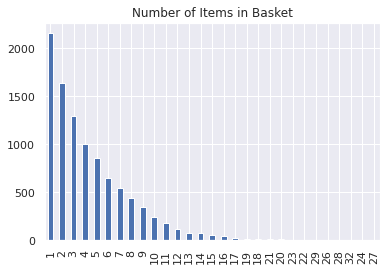

In [99]:
df_basket_cleaned.item_count.value_counts().plot(kind='bar');
plt.title("Number of Items in Basket");

## Grocery Items Cloud

In [100]:
!pip install wordcloud

In [101]:
df_basket_cleaned.columns

Index(['item_count',            0,            1,            2,            3,
                  4,            5,            6,            7,            8,
                  9,           10,           11,           12,           13,
                 14,           15,           16,           17,           18,
                 19,           20,           21,           22,           23,
                 24,           25,           26,           27,           28,
                 29,           30,           31],
      dtype='object')

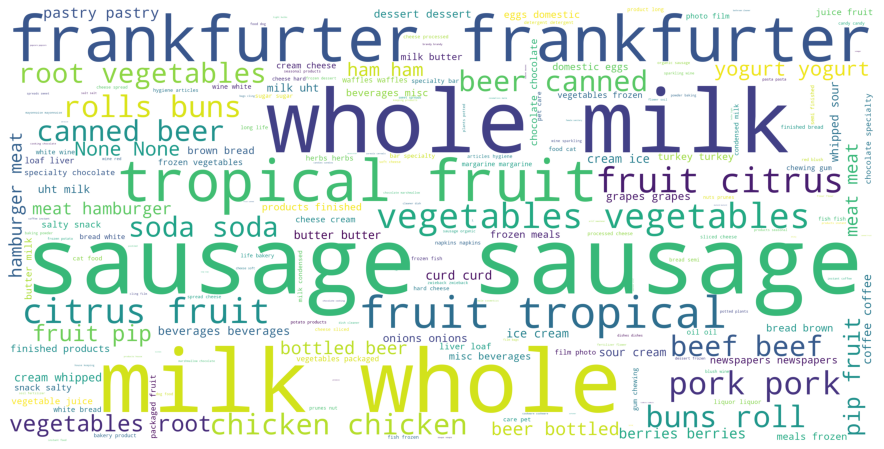

In [102]:

from wordcloud import WordCloud, STOPWORDS

item_corpus = ' '.join(df_basket_cleaned[0]) #' '.join(groceries['basket'])
#stop_words = list(STOPWORDS) #["The", "It", "And", "Or"] + 
#print(stop_words)
item_wordcloud = WordCloud(stopwords=STOPWORDS, background_color='white', height=2000, width=4000).generate(item_corpus)

plt.figure(figsize=(16,8))
plt.imshow(item_wordcloud)
plt.axis('off')
plt.show()

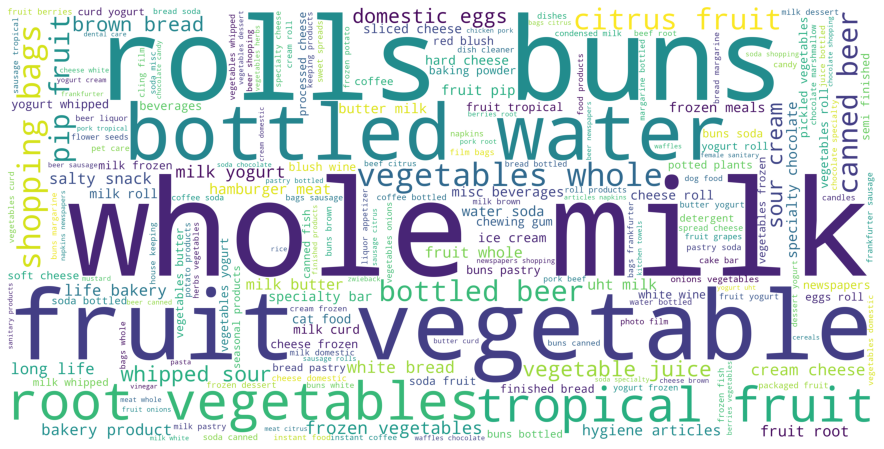

In [ ]:

from wordcloud import WordCloud, STOPWORDS

item_corpus = ' '.join(groceries['basket'])
stop_words = list(STOPWORDS) #["The", "It", "And", "Or"] + 
#print(stop_words)
item_wordcloud = WordCloud(stopwords=stop_words, background_color='white', height=2000, width=4000).generate(item_corpus)

plt.figure(figsize=(16,8))
plt.imshow(item_wordcloud)
plt.axis('off')
plt.show()

## Baskets with same Items
- Identify 
- Evaluate 
- Filter 

In [103]:
len(groceries.basket.unique())

7011

In [104]:
groceries.basket.value_counts()[:50]

canned beer               260
soda                      156
whole milk                121
bottled beer              120
rolls/buns                109
bottled water              67
other vegetables           62
newspapers                 54
shopping bags              48
yogurt                     40
coffee                     39
pastry                     37
chocolate                  35
ice cream                  34
misc. beverages            31
salty snack                30
pip fruit                  28
pork                       27
photo/film                 27
pastry,soda                27
specialty chocolate        26
whipped/sour cream         26
beef                       26
beverages                  26
root vegetables            25
sausage                    24
rolls/buns,soda            23
tropical fruit             23
fruit/vegetable juice      22
waffles                    21
specialty bar              21
brown bread                20
white wine                 19
frankfurte

In [105]:
groceries.duplicated().sum()

2824

In [106]:
groceries['is_multiple'] = groceries.duplicated()

In [107]:
groceries.head()

,basket,is_multiple
0,"citrus fruit,semi-finished bread,margarine,rea...",False
1,"tropical fruit,yogurt,coffee",False
2,whole milk,False
3,"pip fruit,yogurt,cream cheese,meat spreads",False
4,"other vegetables,whole milk,condensed milk,lon...",False


In [108]:
groceries.tail()

,basket,is_multiple
9830,"sausage,chicken,beef,hamburger meat,citrus fru...",False
9831,cooking chocolate,True
9832,"chicken,citrus fruit,other vegetables,butter,y...",False
9833,"semi-finished bread,bottled water,soda,bottled...",False
9834,"chicken,tropical fruit,other vegetables,vinega...",False


In [109]:
groceries.is_multiple.value_counts()

False    7011
True     2824
Name: is_multiple, dtype: int64

**7011 unique baskets and 2824 repeated baskets**

In [110]:
#find the baskets with similar items inside
multiple_baskets = pd.DataFrame(groceries.groupby(['is_multiple','basket'])['is_multiple'].size())
multiple_baskets.columns = ['no_of_baskets']
multiple_baskets.reset_index(inplace=True)
multiple_baskets['basket'] = multiple_baskets.basket.str.lower()
multiple_baskets.sort_values(by=['no_of_baskets'],ascending=[False], inplace=True)
multiple_baskets.head()

,is_multiple,basket,no_of_baskets
7074,True,canned beer,259
7351,True,soda,155
7414,True,whole milk,120
7035,True,bottled beer,119
7281,True,rolls/buns,108


False    7011
True     2824
Name: is_multiple, dtype: int64

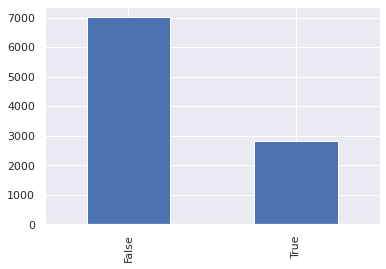

In [111]:
groceries.is_multiple.value_counts().plot(kind='bar');

display(groceries.is_multiple.value_counts());

In [112]:
multiple_baskets.shape

(7474, 3)

In [113]:
unique_baskets = multiple_baskets.where(multiple_baskets.is_multiple == False)
unique_baskets.dropna(inplace=True)
#display(repeated_baskets.isna().sum())

unique_baskets.shape

(7011, 3)

In [114]:
unique_baskets.head()

,is_multiple,basket,no_of_baskets
4865,0.0,"sausage,beverages,brown bread,pastry",1.0
5006,0.0,"sausage,dessert,domestic eggs,rolls/buns,soda,...",1.0
4983,0.0,"sausage,citrus fruit,whole milk,canned beer",1.0
4984,0.0,"sausage,citrus fruit,whole milk,cream cheese,p...",1.0
5016,0.0,"sausage,domestic eggs,zwieback,fruit/vegetable...",1.0


In [115]:
repeated_baskets = multiple_baskets.where(multiple_baskets.is_multiple == True)
repeated_baskets.dropna(inplace=True)
#display(repeated_baskets.isna().sum())

repeated_baskets.shape

(463, 3)

In [116]:
repeated_baskets[repeated_baskets['no_of_baskets']>10]

,is_multiple,basket,no_of_baskets
7074,1.0,canned beer,259.0
7351,1.0,soda,155.0
7414,1.0,whole milk,120.0
7035,1.0,bottled beer,119.0
7281,1.0,rolls/buns,108.0
7047,1.0,bottled water,66.0
7216,1.0,other vegetables,61.0
7210,1.0,newspapers,53.0
7349,1.0,shopping bags,47.0
7456,1.0,yogurt,39.0


Observed that the following **items are bought by multiple customers** - 
- canned beer	259.0
- soda	155.0
- whole milk	120.0
- bottled beer	119.0
- rolls/buns	108.0

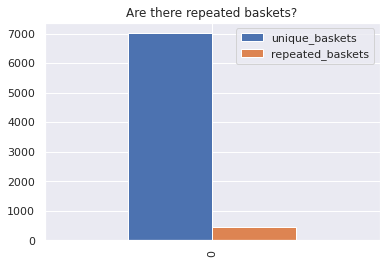

In [117]:
plot_baskets = pd.DataFrame([(unique_baskets.shape[0], repeated_baskets.shape[0])],
                            columns = ('unique_baskets','repeated_baskets'), 
                            )
plot_baskets.plot(kind='bar');
plt.title("Are there repeated baskets?");


In [118]:
multiple_baskets.iloc[:20]

,is_multiple,basket,no_of_baskets
7074,True,canned beer,259
7351,True,soda,155
7414,True,whole milk,120
7035,True,bottled beer,119
7281,True,rolls/buns,108
7047,True,bottled water,66
7216,True,other vegetables,61
7210,True,newspapers,53
7349,True,shopping bags,47
7456,True,yogurt,39


In [119]:
multiple_baskets.tail()

,is_multiple,basket,no_of_baskets
2487,False,"grapes,hard cheese,margarine,specialty fat,new...",1
2486,False,"grapes,hard cheese",1
2485,False,"grapes,fruit/vegetable juice,red/blush wine,lo...",1
2484,False,"grapes,dessert,yogurt,beverages,frozen vegetab...",1
3737,False,"pasta,soda,snack products,cake bar",1


In [120]:
#sns.boxplot(x='basket', y='no_of_baskets', data=multiple_baskets);

In [121]:
multiple_baskets_count = multiple_baskets.is_multiple.value_counts()
multiple_baskets_count

False    7011
True      463
Name: is_multiple, dtype: int64

In [122]:
similar_basket = multiple_baskets.where(groceries.is_multiple == True)

similar_basket.dropna(inplace = True)
similar_basket.shape


(2084, 3)

In [123]:
similar_basket.head(20)

,is_multiple,basket,no_of_baskets
7414,1.0,whole milk,120.0
7035,1.0,bottled beer,119.0
7047,1.0,bottled water,66.0
7349,1.0,shopping bags,47.0
7204,1.0,misc. beverages,30.0
7321,1.0,salty snack,29.0
7256,1.0,pip fruit,27.0
7250,1.0,"pastry,soda",26.0
7014,1.0,beef,25.0
7372,1.0,specialty bar,20.0


In [124]:
len(similar_basket.basket.unique())

2045

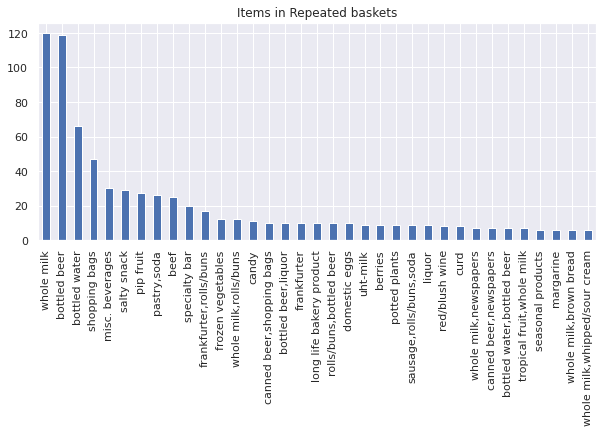

In [125]:
fig, ax = plt.subplots(figsize = (10,4));
similar_basket[:35].no_of_baskets.plot(kind='bar');
plt.title('Items in Repeated baskets');
ax.set_xticklabels(similar_basket.basket[:35], rotation=90);


**Looks like we should drop 'Shopping bags' while doing basket analysis**

In [126]:
grocery_basket_in_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9835 entries, 6813 to 6868
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
 1   1       7676 non-null   object
 2   2       6033 non-null   object
 3   3       4734 non-null   object
 4   4       3729 non-null   object
 5   5       2874 non-null   object
 6   6       2229 non-null   object
 7   7       1684 non-null   object
 8   8       1246 non-null   object
 9   9       896 non-null    object
 10  10      650 non-null    object
 11  11      468 non-null    object
 12  12      351 non-null    object
 13  13      273 non-null    object
 14  14      196 non-null    object
 15  15      141 non-null    object
 16  16      95 non-null     object
 17  17      66 non-null     object
 18  18      52 non-null     object
 19  19      38 non-null     object
 20  20      29 non-null     object
 21  21      18 non-null     object
 22  22      14 non-null  

In [127]:
len(groceries.basket.unique())

7011

In [128]:
len(groceries.basket)

9835

In [129]:
grocery_basket_in_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9835 entries, 6813 to 6868
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
 1   1       7676 non-null   object
 2   2       6033 non-null   object
 3   3       4734 non-null   object
 4   4       3729 non-null   object
 5   5       2874 non-null   object
 6   6       2229 non-null   object
 7   7       1684 non-null   object
 8   8       1246 non-null   object
 9   9       896 non-null    object
 10  10      650 non-null    object
 11  11      468 non-null    object
 12  12      351 non-null    object
 13  13      273 non-null    object
 14  14      196 non-null    object
 15  15      141 non-null    object
 16  16      95 non-null     object
 17  17      66 non-null     object
 18  18      52 non-null     object
 19  19      38 non-null     object
 20  20      29 non-null     object
 21  21      18 non-null     object
 22  22      14 non-null  

In [130]:
#grocery_basket_in_df.boxplot(column='item_count');
#plt.title("Number of items in the basket");

## Evaluate number of items in shopping basket

In [131]:
groceries.shape

(9835, 2)

**Number of Baskets are 9835**

In [132]:
np.sort(df_basket_cleaned.item_count.unique(),axis=0)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 32])

In [133]:
grocery_basket_in_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


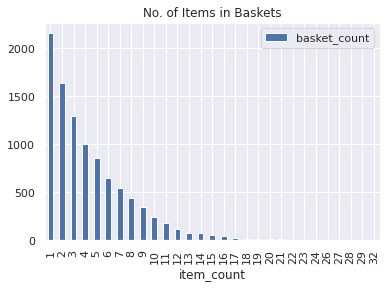

In [134]:
no_of_items_in_basket = df_basket_cleaned.item_count.value_counts()
items_in_basket_df = pd.DataFrame(data=no_of_items_in_basket)
items_in_basket_df.reset_index(inplace=True)
items_in_basket_df.columns = ['item_count','basket_count']
items_in_basket_df.sort_values(by='item_count', ascending=True, inplace=True)
items_in_basket_df.plot(x='item_count', y='basket_count', kind='bar');
plt.title("No. of Items in Baskets");

## Curate Items List

In [135]:
df_cols = grocery_basket_in_df.select_dtypes(include=[object])
#display(df_cols)
df_filtered = []
for col in df_cols:
    a = grocery_basket_in_df[col].unique()
    df_filtered = np.append(df_filtered, a, axis=0)
    
    #print("filtered data\n")
display(df_filtered)
#display(df_filtered.info())
len(df_filtered.tolist())

array(['zwieback', 'yogurt', 'whole milk', ..., 'hygiene articles', None,
       'candles'], dtype=object)

2212

In [136]:
grocery_itemlist = df_filtered.tolist()
grocery_itemlist_df = pd.DataFrame(grocery_itemlist, columns=['item_name'])
display(grocery_itemlist_df.head())

#grocery_itemlist[:10]

,item_name
0,zwieback
1,yogurt
2,whole milk
3,white wine
4,white bread


In [137]:
# handles NaNs
grocery_itemlist_df = grocery_itemlist_df.apply(lambda col: col.str.lower())


In [138]:
grocery_itemlist_df.columns

Index(['item_name'], dtype='object')

In [139]:
grocery_itemlist_df.isna().sum()

item_name    31
dtype: int64

In [140]:
grocery_itemlist_df.dropna(inplace=True)

In [141]:
grocery_curated_itemlist_df = grocery_itemlist_df.drop_duplicates()
grocery_curated_itemlist_df.sort_values(by='item_name', ascending=True, inplace=True)

In [142]:
grocery_curated_itemlist_df.shape

(166, 1)

In [143]:
grocery_curated_itemlist_df

,item_name
154,abrasive cleaner
153,artif. sweetener
152,baby cosmetics
2089,baby food
151,baking powder
150,bathroom cleaner
149,beef
148,berries
147,beverages
146,bottled beer


In [144]:
lb_make = LabelEncoder()

In [145]:
grocery_curated_itemlist_df["item_code"] = lb_make.fit_transform(grocery_curated_itemlist_df["item_name"])
grocery_curated_itemlist_df.head()

,item_name,item_code
154,abrasive cleaner,0
153,artif. sweetener,1
152,baby cosmetics,2
2089,baby food,3
151,baking powder,4


In [146]:
len(grocery_curated_itemlist_df)

166

In [147]:
grocery_curated_itemlist_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 166 entries, 154 to 0
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   item_name  166 non-null    object
 1   item_code  166 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 3.9+ KB


In [148]:
grocery_curated_itemlist_df.sort_values(by='item_name', ascending=True, inplace=True)

In [149]:
grocery_curated_itemlist_df

,item_name,item_code
154,abrasive cleaner,0
153,artif. sweetener,1
152,baby cosmetics,2
2089,baby food,3
151,baking powder,4
150,bathroom cleaner,5
149,beef,6
148,berries,7
147,beverages,8
146,bottled beer,9


**Grocery List has 165 unique items** post cleanup

## Data Preparation - Encode
- Encoding categorical columns


In [150]:
#Extract only the object columns
df_encoded_basket = grocery_basket_in_df.select_dtypes(exclude=['int64'])

df_encoded_basket.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9835 entries, 6813 to 6868
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
 1   1       7676 non-null   object
 2   2       6033 non-null   object
 3   3       4734 non-null   object
 4   4       3729 non-null   object
 5   5       2874 non-null   object
 6   6       2229 non-null   object
 7   7       1684 non-null   object
 8   8       1246 non-null   object
 9   9       896 non-null    object
 10  10      650 non-null    object
 11  11      468 non-null    object
 12  12      351 non-null    object
 13  13      273 non-null    object
 14  14      196 non-null    object
 15  15      141 non-null    object
 16  16      95 non-null     object
 17  17      66 non-null     object
 18  18      52 non-null     object
 19  19      38 non-null     object
 20  20      29 non-null     object
 21  21      18 non-null     object
 22  22      14 non-null  

In [151]:
#convert object columns to categorical columns
df_encoded_basket = df_encoded_basket[df_encoded_basket.columns].apply(lambda x:x.astype('category'))
df_encoded_basket.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9835 entries, 6813 to 6868
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   0       9835 non-null   category
 1   1       7676 non-null   category
 2   2       6033 non-null   category
 3   3       4734 non-null   category
 4   4       3729 non-null   category
 5   5       2874 non-null   category
 6   6       2229 non-null   category
 7   7       1684 non-null   category
 8   8       1246 non-null   category
 9   9       896 non-null    category
 10  10      650 non-null    category
 11  11      468 non-null    category
 12  12      351 non-null    category
 13  13      273 non-null    category
 14  14      196 non-null    category
 15  15      141 non-null    category
 16  16      95 non-null     category
 17  17      66 non-null     category
 18  18      52 non-null     category
 19  19      38 non-null     category
 20  20      29 non-null     category
 21  21      18 

In [152]:
df_encoded_basket.head(20)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1359,zwieback,oil,mustard,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3060,zwieback,long life bakery product,dental care,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6517,zwieback,long life bakery product,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7151,zwieback,dishes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5492,zwieback,cat food,dish cleaner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5117,zwieback,bottled beer,hygiene articles,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5271,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5958,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6520,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [153]:
# get unique values in order
#vals = df_encoded_basket.T.stack().unique()
vals = grocery_curated_itemlist_df.T.stack().unique()
print(len(vals))
vals

332


array(['abrasive cleaner', 'artif. sweetener', 'baby cosmetics',
       'baby food', 'baking powder', 'bathroom cleaner', 'beef',
       'berries', 'beverages', 'bottled beer', 'bottled water', 'brandy',
       'brown bread', 'butter', 'butter milk', 'cake bar', 'candles',
       'candy', 'canned beer', 'canned fish', 'canned fruit',
       'canned vegetables', 'cat food', 'cereals', 'chewing gum',
       'chicken', 'chocolate', 'chocolate marshmallow', 'citrus fruit',
       'cleaner', 'cling film/bags', 'cocoa drinks', 'coffee',
       'condensed milk', 'cooking chocolate', 'cookware', 'cream',
       'cream cheese', 'curd', 'curd cheese', 'decalcifier',
       'dental care', 'dessert', 'detergent', 'dish cleaner', 'dishes',
       'dog food', 'domestic eggs', 'female sanitary products',
       'finished products', 'fish', 'flour', 'flower (seeds)',
       'flower soil/fertilizer', 'frankfurter', 'frozen chicken',
       'frozen dessert', 'frozen fish', 'frozen fruits', 'frozen meals

In [154]:
dict(enumerate(grocery_curated_itemlist_df))

{0: 'item_name', 1: 'item_code'}

In [155]:
# convert to categories and then extract codes
for col in df_encoded_basket:
    df_encoded_basket[col] = pd.Categorical(df_encoded_basket[col], categories=vals)
    df_encoded_basket[col] = df_encoded_basket[col].cat.codes

df_encoded_basket.head(20)    

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,165,125,107,158,26,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
1359,165,95,90,26,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
3060,165,82,41,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
6517,165,82,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
7151,165,45,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5492,165,22,44,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5117,165,9,71,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5271,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5958,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
6520,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1


In [156]:
df_decoded_basket = df_encoded_basket.copy()

In [157]:
decode_items = dict(enumerate(vals))
decode_items

{0: 'abrasive cleaner',
 1: 'artif. sweetener',
 2: 'baby cosmetics',
 3: 'baby food',
 4: 'baking powder',
 5: 'bathroom cleaner',
 6: 'beef',
 7: 'berries',
 8: 'beverages',
 9: 'bottled beer',
 10: 'bottled water',
 11: 'brandy',
 12: 'brown bread',
 13: 'butter',
 14: 'butter milk',
 15: 'cake bar',
 16: 'candles',
 17: 'candy',
 18: 'canned beer',
 19: 'canned fish',
 20: 'canned fruit',
 21: 'canned vegetables',
 22: 'cat food',
 23: 'cereals',
 24: 'chewing gum',
 25: 'chicken',
 26: 'chocolate',
 27: 'chocolate marshmallow',
 28: 'citrus fruit',
 29: 'cleaner',
 30: 'cling film/bags',
 31: 'cocoa drinks',
 32: 'coffee',
 33: 'condensed milk',
 34: 'cooking chocolate',
 35: 'cookware',
 36: 'cream',
 37: 'cream cheese',
 38: 'curd',
 39: 'curd cheese',
 40: 'decalcifier',
 41: 'dental care',
 42: 'dessert',
 43: 'detergent',
 44: 'dish cleaner',
 45: 'dishes',
 46: 'dog food',
 47: 'domestic eggs',
 48: 'female sanitary products',
 49: 'finished products',
 50: 'fish',
 51: 'flo

In [158]:
# convert to codes back to categories
for col in df_decoded_basket:
    df_decoded_basket[col] = df_decoded_basket[col].map(decode_items)
    
df_decoded_basket.head(6)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1359,zwieback,oil,mustard,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3060,zwieback,long life bakery product,dental care,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6517,zwieback,long life bakery product,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7151,zwieback,dishes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5492,zwieback,cat food,dish cleaner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [159]:
df_decoded_basket

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1359,zwieback,oil,mustard,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3060,zwieback,long life bakery product,dental care,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6517,zwieback,long life bakery product,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7151,zwieback,dishes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5492,zwieback,cat food,dish cleaner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5117,zwieback,bottled beer,hygiene articles,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5271,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5958,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6520,zwieback,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [160]:
grocery_basket_in_df.head(12)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


## **EDA Inferences**
- Categorical dataset
- 9835 individual baskets
- 7011 unique baskets
- 2824 repeated baskets (baskets having same items)
- 165 unique items in the store
- Range of 1-32 items in baskets
- Customers buy atleast 1 item from the store
- Atleast 30% baskets with atleast 6 items
- Less than 1% Baskets have more than 16 items 
- 463 repeatable baskets


# Grocery datasets to build models
- ItemList
- BasketList
- Items in Basket

In [161]:
groceries[:10]

,basket,is_multiple
0,"citrus fruit,semi-finished bread,margarine,rea...",False
1,"tropical fruit,yogurt,coffee",False
2,whole milk,False
3,"pip fruit,yogurt,cream cheese,meat spreads",False
4,"other vegetables,whole milk,condensed milk,lon...",False
5,"whole milk,butter,yogurt,rice,abrasive cleaner",False
6,rolls/buns,False
7,"other vegetables,uht-milk,rolls/buns,bottled b...",False
8,potted plants,False
9,"whole milk,cereals",False


In [162]:
grocery_curated_itemlist_df.head()

,item_name,item_code
154,abrasive cleaner,0
153,artif. sweetener,1
152,baby cosmetics,2
2089,baby food,3
151,baking powder,4


In [163]:
grocery_basket_in_df.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


In [164]:
items_in_basket_df.head()

,item_count,basket_count
0,1,2159
1,2,1643
2,3,1299
3,4,1005
4,5,855


In [165]:
decode_items

{0: 'abrasive cleaner',
 1: 'artif. sweetener',
 2: 'baby cosmetics',
 3: 'baby food',
 4: 'baking powder',
 5: 'bathroom cleaner',
 6: 'beef',
 7: 'berries',
 8: 'beverages',
 9: 'bottled beer',
 10: 'bottled water',
 11: 'brandy',
 12: 'brown bread',
 13: 'butter',
 14: 'butter milk',
 15: 'cake bar',
 16: 'candles',
 17: 'candy',
 18: 'canned beer',
 19: 'canned fish',
 20: 'canned fruit',
 21: 'canned vegetables',
 22: 'cat food',
 23: 'cereals',
 24: 'chewing gum',
 25: 'chicken',
 26: 'chocolate',
 27: 'chocolate marshmallow',
 28: 'citrus fruit',
 29: 'cleaner',
 30: 'cling film/bags',
 31: 'cocoa drinks',
 32: 'coffee',
 33: 'condensed milk',
 34: 'cooking chocolate',
 35: 'cookware',
 36: 'cream',
 37: 'cream cheese',
 38: 'curd',
 39: 'curd cheese',
 40: 'decalcifier',
 41: 'dental care',
 42: 'dessert',
 43: 'detergent',
 44: 'dish cleaner',
 45: 'dishes',
 46: 'dog food',
 47: 'domestic eggs',
 48: 'female sanitary products',
 49: 'finished products',
 50: 'fish',
 51: 'flo

In [166]:
df_encoded_basket.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,165,125,107,158,26,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
1359,165,95,90,26,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
3060,165,82,41,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
6517,165,82,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
7151,165,45,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5492,165,22,44,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5117,165,9,71,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5271,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5958,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
6520,165,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1


In [167]:
df_decoded_basket.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,zwieback,salty snack,popcorn,waffles,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1359,zwieback,oil,mustard,chocolate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3060,zwieback,long life bakery product,dental care,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6517,zwieback,long life bakery product,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7151,zwieback,dishes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [168]:
grocery_basket_list # used in apriori algorithm

[['zwieback',
  'salty snack',
  'popcorn',
  'waffles',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'oil',
  'mustard',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  'dental care',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',

In [169]:
df_basket_cleaned[:20]

,item_count,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31
6813,5,zwieback,salty snack,popcorn,waffles,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
1359,4,zwieback,oil,mustard,chocolate,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
3060,3,zwieback,long life bakery product,dental care,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6517,2,zwieback,long life bakery product,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
7151,2,zwieback,dishes,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5492,3,zwieback,cat food,dish cleaner,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5117,3,zwieback,bottled beer,hygiene articles,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5271,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
5958,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
6520,1,zwieback,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None


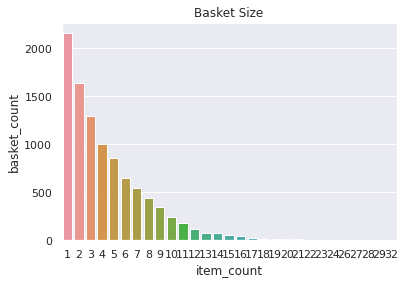

In [170]:
sns.barplot(data=items_in_basket_df, x='item_count', y='basket_count' );
plt.title("Basket Size", fontsize=12);

# ML Models

## Item-Item Recommendation System

We will build a Item-Based Recommendation Engine that computes similarity between products based on baskets. It will suggest items that are bought alongwith some other products.

We do not have a quantitative metric to judge our machine's performance so this will have to be done qualitatively.
In order to do so, we'll use TfidfVectorizer function from scikit-learn, which transforms text to feature vectors that can be used as input to estimator.

Further will be using the Cosine Similarity to calculate a numeric quantity that denotes the similarity between two baskets.
Since we have used the TF-IDF Vectorizer, calculating the Dot Product will directly give us the Cosine Similarity Score.
Therefore, we will use sklearn's linear_kernel instead of cosine_similarities since it is much faster.

#### Prepare Dataset for Item-Item Recommendation

In [ ]:
grocery_recommendation_df = df_decoded_basket.iloc[:,0:3]       #select all rows and 2 items for each basket
grocery_recommendation_df.head()

,0,1,2
6813,zwieback,salty snack,popcorn
1359,zwieback,oil,mustard
3060,zwieback,long life bakery product,dental care
6517,zwieback,long life bakery product,NaN
7151,zwieback,dishes,NaN


In [ ]:
grocery_recommendation_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9835 entries, 6813 to 6868
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       9835 non-null   object
 1   1       7676 non-null   object
 2   2       6033 non-null   object
dtypes: object(3)
memory usage: 307.3+ KB


In [ ]:
grocery_recommendation_df.head()

,0,1,2
6813,zwieback,salty snack,popcorn
1359,zwieback,oil,mustard
3060,zwieback,long life bakery product,dental care
6517,zwieback,long life bakery product,NaN
7151,zwieback,dishes,NaN


In [ ]:
grocery_recommendation_df.reset_index(inplace=True)

In [ ]:
grocery_recommendation_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9835 entries, 0 to 9834
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   index   9835 non-null   int64 
 1   0       9835 non-null   object
 2   1       7676 non-null   object
 3   2       6033 non-null   object
dtypes: int64(1), object(3)
memory usage: 307.5+ KB


In [ ]:
grocery_recommendation_df.columns = ['basket_id', 'product1','product2', 'product3']

In [ ]:
grocery_recommendation_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9835 entries, 0 to 9834
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   basket_id  9835 non-null   int64 
 1   product1   9835 non-null   object
 2   product2   7676 non-null   object
 3   product3   6033 non-null   object
dtypes: int64(1), object(3)
memory usage: 307.5+ KB


In [ ]:
grocery_recommendation_df.head()

,basket_id,product1,product2,product3
0,6813,zwieback,salty snack,popcorn
1,1359,zwieback,oil,mustard
2,3060,zwieback,long life bakery product,dental care
3,6517,zwieback,long life bakery product,NaN
4,7151,zwieback,dishes,NaN


In [ ]:
grocery_recommendation_df.shape

(9835, 4)

In [ ]:
grocery_subset = grocery_recommendation_df#[:10]

In [ ]:
grocery_subset

,basket_id,product1,product2,product3
0,6813,zwieback,salty snack,popcorn
1,1359,zwieback,oil,mustard
2,3060,zwieback,long life bakery product,dental care
3,6517,zwieback,long life bakery product,NaN
4,7151,zwieback,dishes,NaN
5,5492,zwieback,cat food,dish cleaner
6,5117,zwieback,bottled beer,hygiene articles
7,5271,zwieback,NaN,NaN
8,5958,zwieback,NaN,NaN
9,6520,zwieback,NaN,NaN


In [ ]:
grocery_transactions_df = grocery_subset.melt('basket_id').sort_values('basket_id')
grocery_transactions_df.columns = ['basket_id', 'product_num', 'product_name']
grocery_transactions_df.head()

,basket_id,product_num,product_name
27432,0,product3,margarine
7762,0,product1,citrus fruit
17597,0,product2,semi-finished bread
20909,1,product3,coffee
11074,1,product2,yogurt


In [ ]:
#grocery_transactions_df.sort_values(by='product_name', ascending=False,inplace=True)
grocery_transactions_df.head(10)


,basket_id,product_num,product_name
27432,0,product3,margarine
7762,0,product1,citrus fruit
17597,0,product2,semi-finished bread
20909,1,product3,coffee
11074,1,product2,yogurt
1239,1,product1,tropical fruit
20504,2,product3,NaN
834,2,product1,whole milk
10669,2,product2,NaN
14030,3,product2,yogurt


In [ ]:
grocery_transactions_df

,basket_id,product_num,product_name
27432,0,product3,margarine
7762,0,product1,citrus fruit
17597,0,product2,semi-finished bread
20909,1,product3,coffee
11074,1,product2,yogurt
1239,1,product1,tropical fruit
20504,2,product3,NaN
834,2,product1,whole milk
10669,2,product2,NaN
14030,3,product2,yogurt


In [ ]:
grocery_transactions_df.shape

(29505, 3)

In [ ]:
grocery_transactions_df.dropna(inplace=True)

In [ ]:
grocery_transactions_df.shape

(23544, 3)

In [ ]:
grocery_transactions_df.product_name.isna().sum()

0

In [ ]:
grocery_transactions_df.reset_index(inplace=True, drop=True)

In [ ]:
grocery_transactions_df.shape

(23544, 3)

In [ ]:
grocery_transactions_df.columns

Index(['basket_id', 'product_num', 'product_name'], dtype='object')

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tf = TfidfVectorizer(analyzer='word',ngram_range=(1,2),min_df=0, stop_words='english')
tfidf_matrix = tf.fit_transform(grocery_transactions_df['product_name'])
tfidf_matrix.shape

(23544, 294)

In [ ]:
tfidf_matrix

<23544x294 sparse matrix of type '<class 'numpy.float64'>'
	with 47580 stored elements in Compressed Sparse Row format>

In [ ]:
from sklearn.metrics.pairwise import linear_kernel
cosine_sim = linear_kernel(tfidf_matrix, tfidf_matrix)
cosine_sim[:4, :4]

array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 0., 1.]])

In [ ]:
cosine_sim

In [ ]:
cosine_sim.shape

(23544, 23544)

In [ ]:
grocery_transactions_df.head()

,basket_id,product_num,product_name
0,0,product3,margarine
1,0,product1,citrus fruit
2,0,product2,semi-finished bread
3,1,product3,coffee
4,1,product2,yogurt


In [ ]:
#titles = movies['title']
#indices = pd.Series(movies.index, index=movies['title'])

prod = grocery_transactions_df['product_name']
indices = pd.Series(grocery_transactions_df.index, index=grocery_transactions_df['product_name'])

In [ ]:
len(indices)

In [ ]:
prod[:34]

0               margarine
1            citrus fruit
2     semi-finished bread
3                  coffee
4                  yogurt
5          tropical fruit
6              whole milk
7                  yogurt
8               pip fruit
9            cream cheese
10       other vegetables
11             whole milk
12         condensed milk
13             whole milk
14                 yogurt
15                 butter
16             rolls/buns
17               uht-milk
18             rolls/buns
19       other vegetables
20          potted plants
21                cereals
22             whole milk
23            white bread
24       other vegetables
25         tropical fruit
26             whole milk
27           citrus fruit
28         tropical fruit
29                   beef
30             rolls/buns
31            frankfurter
32                   soda
33         tropical fruit
Name: product_name, dtype: object

In [ ]:
indices[:16]

#### Product recommendations
- based on the cosine similarity score of products 

In [ ]:
def product_recommendations(product):
    idx = indices[product]
    #print("0: ",idx)
    #print("1: ",cosine_sim[idx])
    #print("2: ",list(enumerate(cosine_sim[idx])))
    sim_scores = list(enumerate(cosine_sim[idx]))
    #print("1: ",sim_scores)
    sim_scores = sorted(sim_scores, key=lambda x: np.all(x[1]), reverse=False) #sorted(sim_scores, key=None, reverse=False) 
    #print("2: ",sim_scores)
    sim_scores = sim_scores[1:21]
    #print("3: ",sim_scores)
    prod_indices = [i[0] for i in sim_scores]
    #print("4: ",prod_indices)
    recommend_prods = list(set(prod[prod_indices]))
    return recommend_prods

In [ ]:
product_recommendations('salty snack')

['condensed milk',
 'coffee',
 'whole milk',
 'yogurt',
 'rolls/buns',
 'other vegetables',
 'pip fruit',
 'cream cheese',
 'uht-milk',
 'potted plants',
 'butter',
 'semi-finished bread',
 'citrus fruit',
 'tropical fruit']

In [ ]:
product_recommendations('whole milk')

['condensed milk',
 'coffee',
 'whole milk',
 'yogurt',
 'rolls/buns',
 'other vegetables',
 'pip fruit',
 'cream cheese',
 'uht-milk',
 'potted plants',
 'butter',
 'semi-finished bread',
 'citrus fruit',
 'tropical fruit']

Let's try and get the recommendations for a not so popular item from the store.

In [ ]:
product_recommendations('popcorn')

['condensed milk',
 'coffee',
 'whole milk',
 'yogurt',
 'other vegetables',
 'pip fruit',
 'cream cheese',
 'semi-finished bread',
 'citrus fruit',
 'tropical fruit']

In [ ]:
product_recommendations('yogurt')

['condensed milk',
 'coffee',
 'whole milk',
 'yogurt',
 'rolls/buns',
 'other vegetables',
 'pip fruit',
 'cream cheese',
 'uht-milk',
 'potted plants',
 'butter',
 'semi-finished bread',
 'citrus fruit',
 'tropical fruit']

## Apriori Algorithm

Transform the available dataset such that 
- each row represents a transaction and each column an individual item of the transaction
- determine the frequent item sets of this dataset
- the association rules can be determined
- setup the rule that if the SKU is part of atleast 3 baskets, it's classified as frequent item
- uses a "bottom up" approach, where frequent subsets are extended one item at a time


In [ ]:
grocery_basket_list


[['zwieback',
  'salty snack',
  'popcorn',
  'waffles',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'oil',
  'mustard',
  'chocolate',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  'dental care',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0'],
 ['zwieback',
  'long life bakery product',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',

In [ ]:
te = TransactionEncoder()
te_ary = te.fit(grocery_basket_list).transform(grocery_basket_list)
te_ary

array([[ True, False, False, ..., False, False,  True],
       [ True, False, False, ..., False, False,  True],
       [ True, False, False, ..., False, False,  True],
       ...,
       [ True, False, False, ..., False, False, False],
       [ True, False,  True, ..., False, False, False],
       [ True, False,  True, ..., False, False, False]])

In [ ]:
x = te.fit(grocery_basket_list)
x.columns_

['0',
 'None',
 'abrasive cleaner',
 'artif. sweetener',
 'baby cosmetics',
 'baby food',
 'baking powder',
 'bathroom cleaner',
 'beef',
 'berries',
 'beverages',
 'bottled beer',
 'brandy',
 'brown bread',
 'butter',
 'butter milk',
 'cake bar',
 'candles',
 'candy',
 'canned beer',
 'canned fish',
 'canned fruit',
 'canned vegetables',
 'cat food',
 'cereals',
 'chewing gum',
 'chicken',
 'chocolate',
 'chocolate marshmallow',
 'citrus fruit',
 'cleaner',
 'cling film/bags',
 'cocoa drinks',
 'coffee',
 'condensed milk',
 'cooking chocolate',
 'cookware',
 'cream',
 'cream cheese',
 'curd',
 'curd cheese',
 'decalcifier',
 'dental care',
 'dessert',
 'detergent',
 'dish cleaner',
 'dishes',
 'dog food',
 'domestic eggs',
 'female sanitary products',
 'finished products',
 'fish',
 'flour',
 'flower (seeds)',
 'flower soil/fertilizer',
 'frankfurter',
 'frozen chicken',
 'frozen dessert',
 'frozen fish',
 'frozen fruits',
 'frozen meals',
 'frozen potato products',
 'frozen vegetable

In [ ]:
df = pd.DataFrame(te_ary, columns=te.columns_)
df.head()

,0,None,abrasive cleaner,artif. sweetener,baby cosmetics,baby food,baking powder,bathroom cleaner,beef,berries,beverages,bottled beer,brandy,brown bread,butter,butter milk,cake bar,candles,candy,canned beer,canned fish,canned fruit,canned vegetables,cat food,cereals,chewing gum,chicken,chocolate,chocolate marshmallow,citrus fruit,cleaner,cling film/bags,cocoa drinks,coffee,condensed milk,cooking chocolate,cookware,cream,cream cheese,curd,curd cheese,decalcifier,dental care,dessert,detergent,dish cleaner,dishes,dog food,domestic eggs,female sanitary products,finished products,fish,flour,flower (seeds),flower soil/fertilizer,frankfurter,frozen chicken,frozen dessert,frozen fish,frozen fruits,frozen meals,frozen potato products,frozen vegetables,fruit/vegetable juice,grapes,hair spray,ham,hamburger meat,hard cheese,herbs,honey,house keeping products,hygiene articles,ice cream,instant coffee,instant food products,jam,ketchup,kitchen towels,kitchen utensil,light bulbs,liquor,liver loaf,long life bakery product,make up remover,male cosmetics,margarine,mayonnaise,meat,meat spreads,misc. beverages,mustard,napkins,newspapers,nut snack,nuts/prunes,oil,onions,organic products,organic sausage,other vegetables,packaged fruit/vegetables,pasta,pastry,pet care,photo/film,pickled vegetables,pip fruit,popcorn,pork,potato products,potted plants,preservation products,processed cheese,prosecco,pudding powder,ready soups,red/blush wine,rice,roll products,rolls/buns,root vegetables,rubbing alcohol,rum,salad dressing,salt,salty snack,sauces,sausage,seasonal products,semi-finished bread,skin care,sliced cheese,snack products,soap,soda,soft cheese,softener,sound storage medium,soups,sparkling wine,specialty bar,specialty cheese,specialty chocolate,specialty fat,specialty vegetables,spices,spread cheese,sugar,sweet spreads,syrup,tea,tidbits,toilet cleaner,tropical fruit,turkey,uht-milk,vinegar,waffles,whipped/sour cream,whisky,white bread,white wine,whole milk,yogurt,zwieback
0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
1,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
2,True,False,False,False,False,

In [ ]:
df.head(20)

,0,None,abrasive cleaner,artif. sweetener,baby cosmetics,baby food,baking powder,bathroom cleaner,beef,berries,beverages,bottled beer,brandy,brown bread,butter,butter milk,cake bar,candles,candy,canned beer,canned fish,canned fruit,canned vegetables,cat food,cereals,chewing gum,chicken,chocolate,chocolate marshmallow,citrus fruit,cleaner,cling film/bags,cocoa drinks,coffee,condensed milk,cooking chocolate,cookware,cream,cream cheese,curd,curd cheese,decalcifier,dental care,dessert,detergent,dish cleaner,dishes,dog food,domestic eggs,female sanitary products,finished products,fish,flour,flower (seeds),flower soil/fertilizer,frankfurter,frozen chicken,frozen dessert,frozen fish,frozen fruits,frozen meals,frozen potato products,frozen vegetables,fruit/vegetable juice,grapes,hair spray,ham,hamburger meat,hard cheese,herbs,honey,house keeping products,hygiene articles,ice cream,instant coffee,instant food products,jam,ketchup,kitchen towels,kitchen utensil,light bulbs,liquor,liver loaf,long life bakery product,make up remover,male cosmetics,margarine,mayonnaise,meat,meat spreads,misc. beverages,mustard,napkins,newspapers,nut snack,nuts/prunes,oil,onions,organic products,organic sausage,other vegetables,packaged fruit/vegetables,pasta,pastry,pet care,photo/film,pickled vegetables,pip fruit,popcorn,pork,potato products,potted plants,preservation products,processed cheese,prosecco,pudding powder,ready soups,red/blush wine,rice,roll products,rolls/buns,root vegetables,rubbing alcohol,rum,salad dressing,salt,salty snack,sauces,sausage,seasonal products,semi-finished bread,skin care,sliced cheese,snack products,soap,soda,soft cheese,softener,sound storage medium,soups,sparkling wine,specialty bar,specialty cheese,specialty chocolate,specialty fat,specialty vegetables,spices,spread cheese,sugar,sweet spreads,syrup,tea,tidbits,toilet cleaner,tropical fruit,turkey,uht-milk,vinegar,waffles,whipped/sour cream,whisky,white bread,white wine,whole milk,yogurt,zwieback
0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
1,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
2,True,False,False,False,False,

In [ ]:
df.shape

(9835, 166)

In [ ]:
df.describe()

,0,None,abrasive cleaner,artif. sweetener,baby cosmetics,baby food,baking powder,bathroom cleaner,beef,berries,beverages,bottled beer,brandy,brown bread,butter,butter milk,cake bar,candles,candy,canned beer,canned fish,canned fruit,canned vegetables,cat food,cereals,chewing gum,chicken,chocolate,chocolate marshmallow,citrus fruit,cleaner,cling film/bags,cocoa drinks,coffee,condensed milk,cooking chocolate,cookware,cream,cream cheese,curd,curd cheese,decalcifier,dental care,dessert,detergent,dish cleaner,dishes,dog food,domestic eggs,female sanitary products,finished products,fish,flour,flower (seeds),flower soil/fertilizer,frankfurter,frozen chicken,frozen dessert,frozen fish,frozen fruits,frozen meals,frozen potato products,frozen vegetables,fruit/vegetable juice,grapes,hair spray,ham,hamburger meat,hard cheese,herbs,honey,house keeping products,hygiene articles,ice cream,instant coffee,instant food products,jam,ketchup,kitchen towels,kitchen utensil,light bulbs,liquor,liver loaf,long life bakery product,make up remover,male cosmetics,margarine,mayonnaise,meat,meat spreads,misc. beverages,mustard,napkins,newspapers,nut snack,nuts/prunes,oil,onions,organic products,organic sausage,other vegetables,packaged fruit/vegetables,pasta,pastry,pet care,photo/film,pickled vegetables,pip fruit,popcorn,pork,potato products,potted plants,preservation products,processed cheese,prosecco,pudding powder,ready soups,red/blush wine,rice,roll products,rolls/buns,root vegetables,rubbing alcohol,rum,salad dressing,salt,salty snack,sauces,sausage,seasonal products,semi-finished bread,skin care,sliced cheese,snack products,soap,soda,soft cheese,softener,sound storage medium,soups,sparkling wine,specialty bar,specialty cheese,specialty chocolate,specialty fat,specialty vegetables,spices,spread cheese,sugar,sweet spreads,syrup,tea,tidbits,toilet cleaner,tropical fruit,turkey,uht-milk,vinegar,waffles,whipped/sour cream,whisky,white bread,white wine,whole milk,yogurt,zwieback
count,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835,9835
unique,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
top,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,Fals

In [ ]:
#df.value_counts(['shopping bags'])

Let's drop columns - 
- 0 and 
- None

In [ ]:
df.columns

Index(['0', 'None', 'abrasive cleaner', 'artif. sweetener', 'baby cosmetics',
       'baby food', 'baking powder', 'bathroom cleaner', 'beef', 'berries',
       ...
       'uht-milk', 'vinegar', 'waffles', 'whipped/sour cream', 'whisky',
       'white bread', 'white wine', 'whole milk', 'yogurt', 'zwieback'],
      dtype='object', length=166)

In [ ]:
df.drop(columns=['0','None'], inplace=True)

In [ ]:
df.columns

Index(['abrasive cleaner', 'artif. sweetener', 'baby cosmetics', 'baby food',
       'baking powder', 'bathroom cleaner', 'beef', 'berries', 'beverages',
       'bottled beer',
       ...
       'uht-milk', 'vinegar', 'waffles', 'whipped/sour cream', 'whisky',
       'white bread', 'white wine', 'whole milk', 'yogurt', 'zwieback'],
      dtype='object', length=164)

### Iteation #1
**Creating association rules with minimum support of 0.01 (~1%)**
- Support is an indication of how frequently the itemset appears in the dataset.
- Confidence is an indication of how often the rule has been found to be true.
- Lift strengthens the fact that customer buying A will definitely buy B

In [ ]:
#min_support of 0.01 

itemsets_01 = apriori(df, use_colnames=True,min_support=0.01, max_len=3, n_jobs=4 )
itemsets_01.shape

(304, 2)

In [ ]:
itemsets_01.sort_values(by='support', ascending=False)

,support,itemsets
84,0.255516,(whole milk)
53,0.193493,(other vegetables)
64,0.183935,(rolls/buns)
72,0.174377,(soda)
85,0.139502,(yogurt)
65,0.108998,(root vegetables)
78,0.104931,(tropical fruit)
68,0.093950,(sausage)
56,0.088968,(pastry)
17,0.082766,(citrus fruit)


**creating association rules to identify the sales strategy that if user buys product A should we offer discounts or options for the user to buy product B**

In [ ]:
#creating association rules to identify thesales strategy that if user buys product A should we offer discounts or options for the user to buy product B
rules_sup01  =  association_rules(itemsets_01, min_threshold = 0.2,metric='confidence') #min_threshold = 0.02
rules_sup01.shape

(224, 9)

In [ ]:
rules_sup01.sort_values(by = ['confidence', 'lift'], ascending = [False, False], inplace=True )

In [ ]:
rules_sup01

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
147,"(citrus fruit, root vegetables)",(other vegetables),0.017692,0.193493,0.010371,0.586207,3.029608,0.006948,1.949059
176,"(root vegetables, tropical fruit)",(other vegetables),0.021047,0.193493,0.012303,0.584541,3.020999,0.008231,1.941244
153,"(curd, yogurt)",(whole milk),0.017285,0.255516,0.010066,0.582353,2.279125,0.005649,1.782567
143,"(other vegetables, butter)",(whole milk),0.020031,0.255516,0.011490,0.573604,2.244885,0.006371,1.745992
212,"(root vegetables, tropical fruit)",(whole milk),0.021047,0.255516,0.011998,0.570048,2.230969,0.006620,1.731553
214,"(yogurt, root vegetables)",(whole milk),0.025826,0.255516,0.014540,0.562992,2.203354,0.007941,1.703594
155,"(domestic eggs, other vegetables)",(whole milk),0.022267,0.255516,0.012303,0.552511,2.162336,0.006613,1.663694
222,"(yogurt, whipped/sour cream)",(whole milk),0.020742,0.255516,0.010880,0.524510,2.052747,0.005580,1.565719
203,"(root vegetables, rolls/buns)",(whole milk),0.024301,0.255516,0.012710,0.523013,2.046888,0.006500,1.560804
161,"(pip fruit, other vegetables)",(whole milk),0.026131,0.255516,0.013523,0.517510,2.025351,0.006846,1.543003


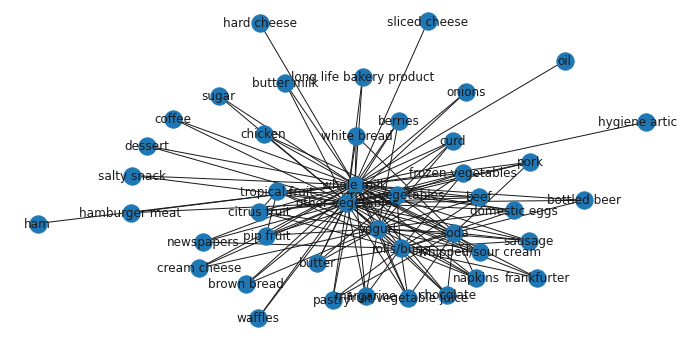

In [ ]:
import networkx as nx
rules_sup01.antecedents  =  rules_sup01.antecedents.apply(lambda x: next(iter(x)))
rules_sup01.consequents  =  rules_sup01.consequents.apply(lambda x: next(iter(x)))
fig, ax = plt.subplots(figsize = (12,6))
GA = nx.from_pandas_edgelist(rules_sup01,source = 'antecedents',target = 'consequents')
nx.draw(GA,with_labels = True)

### Iteartion #2

In [ ]:
#creating association rules to identify thesales strategy that if user buys product A should we offer discounts or options for the user to buy product B
rules_sup02  =  association_rules(itemsets_01, min_threshold = 0.4,metric='confidence') #min_threshold = 0.4
rules_sup02.shape

(61, 9)

In [ ]:
rules_sup02.sort_values(by='lift', ascending=False,inplace=True)
rules_sup02

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
27,"(citrus fruit, root vegetables)",(other vegetables),0.017692,0.193493,0.010371,0.586207,3.029608,0.006948,1.949059
42,"(root vegetables, tropical fruit)",(other vegetables),0.021047,0.193493,0.012303,0.584541,3.020999,0.008231,1.941244
40,"(root vegetables, rolls/buns)",(other vegetables),0.024301,0.193493,0.012201,0.502092,2.594890,0.007499,1.619792
45,"(yogurt, root vegetables)",(other vegetables),0.025826,0.193493,0.012913,0.500000,2.584078,0.007916,1.613015
52,"(yogurt, whipped/sour cream)",(other vegetables),0.020742,0.193493,0.010168,0.490196,2.533410,0.006154,1.581995
44,"(root vegetables, whole milk)",(other vegetables),0.048907,0.193493,0.023183,0.474012,2.449770,0.013719,1.533320
15,(onions),(other vegetables),0.031012,0.193493,0.014235,0.459016,2.372268,0.008234,1.490817
39,"(pork, whole milk)",(other vegetables),0.022166,0.193493,0.010168,0.458716,2.370714,0.005879,1.489988
51,"(whole milk, whipped/sour cream)",(other vegetables),0.032232,0.193493,0.014642,0.454259,2.347679,0.008405,1.477820
37,"(pip fruit, whole milk)",(other vegetables),0.030097,0.193493,0.013523,0.449324,2.322178,0.007700,1.464578


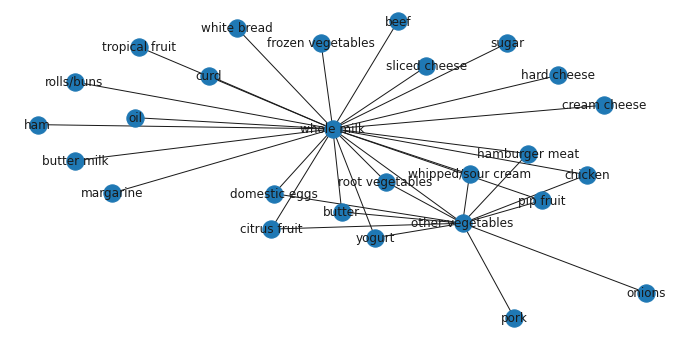

In [ ]:
import networkx as nx
rules_sup02.antecedents  =  rules_sup02.antecedents.apply(lambda x: next(iter(x)))
rules_sup02.consequents  =  rules_sup02.consequents.apply(lambda x: next(iter(x)))
fig, ax = plt.subplots(figsize = (12,6))
GA = nx.from_pandas_edgelist(rules_sup02,source = 'antecedents',target = 'consequents')
nx.draw(GA,with_labels = True)

### Iteration #3

In [ ]:
#min_support of 0.04 

itemsets_03 = apriori(df, use_colnames=True,min_support=0.025, max_len=3, n_jobs=4 )
display(itemsets_03.shape)
itemsets_03

(84, 2)

,support,itemsets
0,0.052466,(beef)
1,0.033249,(berries)
2,0.026029,(beverages)
3,0.080529,(bottled beer)
4,0.064870,(brown bread)
5,0.055414,(butter)
6,0.027961,(butter milk)
7,0.029893,(candy)
8,0.077682,(canned beer)
9,0.042908,(chicken)


In [ ]:
rules_sup03  =  association_rules(itemsets_03, min_threshold = 0.39,metric='confidence') #min_threshold = 0.02
display(rules_sup03.shape)
rules_sup03

(10, 9)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(butter),(whole milk),0.055414,0.255516,0.027555,0.497248,1.946053,0.013395,1.480817
1,(curd),(whole milk),0.053279,0.255516,0.026131,0.490458,1.919481,0.012517,1.461085
2,(domestic eggs),(whole milk),0.063447,0.255516,0.029995,0.472756,1.850203,0.013783,1.412030
3,(root vegetables),(other vegetables),0.108998,0.193493,0.047382,0.434701,2.246605,0.026291,1.426693
4,(whipped/sour cream),(other vegetables),0.071683,0.193493,0.028876,0.402837,2.081924,0.015006,1.350565
5,(pip fruit),(whole milk),0.075648,0.255516,0.030097,0.397849,1.557043,0.010767,1.236375
6,(root vegetables),(whole milk),0.108998,0.255516,0.048907,0.448694,1.756031,0.021056,1.350401
7,(tropical fruit),(whole milk),0.104931,0.255516,0.042298,0.403101,1.577595,0.015486,1.247252
8,(whipped/sour cream),(whole milk),0.071683,0.255516,0.032232,0.449645,1.759754,0.013916,1.352735
9,(yogurt),(whole milk),0.139502,0.255516,0.056024,0.401603,1.571735,0.020379,1.244132


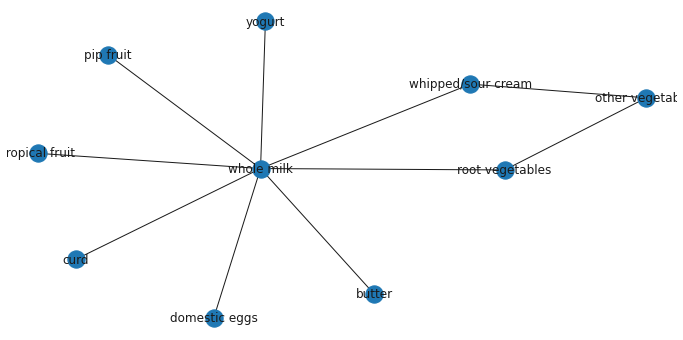

In [ ]:
import networkx as nx
rules_sup03.antecedents  =  rules_sup03.antecedents.apply(lambda x: next(iter(x)))
rules_sup03.consequents  =  rules_sup03.consequents.apply(lambda x: next(iter(x)))
fig, ax = plt.subplots(figsize = (12,6))
GA = nx.from_pandas_edgelist(rules_sup03,source = 'antecedents',target = 'consequents')
nx.draw(GA,with_labels = True)

From the above Network chart, it is construed that the customers buying **Whole Milk** the customer could be offerred the following items as well - 
- Soda
- Rolls / Buns
- Yogurt
- Root Vegetables
- Other Vegetables
- Tropical Fruits

# Model Evaluation



- Support is an indication of how frequently the itemset appears in the dataset.
Confidence is an indication of how often the rule has been found to be true.
Lift strengthens the fact that customer buying A will definitely buy B
- Confidence Level - refers to the likelihood that an item B is also bought if item A is bought
- Lift - refers to the likelihood that item B is purchased when item A is purchased, while controlling for how popular item B is.

## Conclusion

- Whole Milk and Other Vegetables are the bestseller of this grocery store
- Whole Milk shows association with 7 items - 
  - yogurt, 
  - tropical fruit,
  - other vegetables, 
  - root vegetables
  - domestic egg,
  - butter,
  - whipped/sour cream. 

  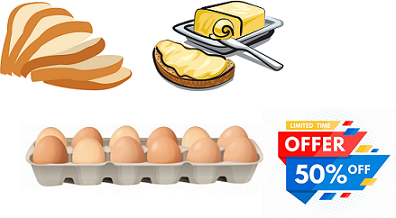

Following strategies could be adopted to increase its sales considering the association we have seen between Whole Milk and its partners.

1. Promotional offers/discounts can be applied by promoting a less sold product along with **whole milk**.

2. Placing vegetables and dairy items near to the ordering counter can be a good strategy to attract customers in buying all of these products and there by increasing sales.

3. Recommend customers to buy additional items for e.g. buy Popcorn when buying any of the following 
'condensed milk', 'coffee', 'whole milk',  'yogurt',  'other vegetables', 'pip fruit', 'cream cheese', 'semi-finished bread','citrus fruit','tropical fruit'

